# Image Classification - MobileNet v2 Transfer Learning

In [1]:
# Immport Libraries
import numpy as np
import tensorflow.keras as keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.mobilenet import preprocess_input, decode_predictions
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense
from tensorflow.keras.models import Model

from IPython.display import Image

C:\Users\bimbim\AppData\Roaming\Python\Python38\site-packages\requests\__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.3) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "


## Load Model (Keras built-in)

In [2]:
# Load Mobile
model = keras.applications.mobilenet_v2.MobileNetV2()

In [3]:
def prepare_image(filepath):
   img = image.load_img(filepath, target_size=(224, 224))
   img_array = image.img_to_array(img)
   img_array_expanded_dims = np.expand_dims(img_array, axis=0)
   return keras.applications.mobilenet.preprocess_input(img_array_expanded_dims)

## Download Images from Internet

### Install google_images_download

In [4]:
%pip install google_images_download

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


You should consider upgrading via the 'c:\Program Files\Python38\python.exe -m pip install --upgrade pip' command.


In [5]:
# import google_images_download
from google_images_download import google_images_download
response = google_images_download.googleimagesdownload()

In [6]:
# Data Generator
train_datagen=ImageDataGenerator(preprocessing_function=preprocess_input)

train_generator=train_datagen.flow_from_directory('D:\Tugas Akhir\Dataset\BERSIH',
                                                target_size=(224,224),
                                                color_mode='rgb',
                                                batch_size=32,
                                                class_mode='categorical',
                                                shuffle=True)

Found 337 images belonging to 2 classes.


In [7]:
num_classes = 2
prediction_dict = {0: "boulder", 1: "branching"}

In [8]:
# Load Model (MobieNet V2)
base_model=keras.applications.mobilenet_v2.MobileNetV2(input_shape=(224,224,3),weights='imagenet',include_top=False) #imports the mobilenet model and discards the last 1000 neuron layer.

# Add Extra Layers to Model
x=base_model.output
x=GlobalAveragePooling2D()(x)
x=Dense(1024,activation='relu')(x) #we add dense layers so that the model can learn more complex functions and classify for better results.
x=Dense(1024,activation='relu')(x) #dense layer 2
x=Dense(512,activation='relu')(x) #dense layer 3
preds=Dense(num_classes,activation='softmax')(x) #final layer with softmax activation

model=Model(inputs=base_model.input,outputs=preds)

In [9]:
# Check layers no. & name
for i,layer in enumerate(model.layers):
    print(i,layer.name)

0 input_2
1 Conv1
2 bn_Conv1
3 Conv1_relu
4 expanded_conv_depthwise
5 expanded_conv_depthwise_BN
6 expanded_conv_depthwise_relu
7 expanded_conv_project
8 expanded_conv_project_BN
9 block_1_expand
10 block_1_expand_BN
11 block_1_expand_relu
12 block_1_pad
13 block_1_depthwise
14 block_1_depthwise_BN
15 block_1_depthwise_relu
16 block_1_project
17 block_1_project_BN
18 block_2_expand
19 block_2_expand_BN
20 block_2_expand_relu
21 block_2_depthwise
22 block_2_depthwise_BN
23 block_2_depthwise_relu
24 block_2_project
25 block_2_project_BN
26 block_2_add
27 block_3_expand
28 block_3_expand_BN
29 block_3_expand_relu
30 block_3_pad
31 block_3_depthwise
32 block_3_depthwise_BN
33 block_3_depthwise_relu
34 block_3_project
35 block_3_project_BN
36 block_4_expand
37 block_4_expand_BN
38 block_4_expand_relu
39 block_4_depthwise
40 block_4_depthwise_BN
41 block_4_depthwise_relu
42 block_4_project
43 block_4_project_BN
44 block_4_add
45 block_5_expand
46 block_5_expand_BN
47 block_5_expand_relu
48 b

In [10]:
# set extra layers to trainable (layer #155~159)
for layer in model.layers[:155]:
    layer.trainable=False
for layer in model.layers[155:]:
    layer.trainable=True

# Compile Model
model.compile(loss='categorical_crossentropy', optimizer='adam',metrics=['accuracy'])
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )                                                             

                                                                                                  
 block_1_pad (ZeroPadding2D)    (None, 113, 113, 96  0           ['block_1_expand_relu[0][0]']    
                                )                                                                 
                                                                                                  
 block_1_depthwise (DepthwiseCo  (None, 56, 56, 96)  864         ['block_1_pad[0][0]']            
 nv2D)                                                                                            
                                                                                                  
 block_1_depthwise_BN (BatchNor  (None, 56, 56, 96)  384         ['block_1_depthwise[0][0]']      
 malization)                                                                                      
                                                                                                  
 block_1_d

In [11]:
# Train Model (target is loss <0.01)
num_epochs = 20
step_size_train=train_generator.n//train_generator.batch_size
model.fit_generator(generator=train_generator, steps_per_epoch=step_size_train, epochs=num_epochs)

C:\Users\bimbim\AppData\Local\Temp\ipykernel_27216\3286323135.py:4: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  model.fit_generator(generator=train_generator, steps_per_epoch=step_size_train, epochs=num_epochs)


Epoch 1/20
10/10 [==============================] - 15s 977ms/step - loss: 0.2794 - accuracy: 0.8820
Epoch 2/20
10/10 [==============================] - 8s 742ms/step - loss: 0.0065 - accuracy: 0.9967
Epoch 3/20
10/10 [==============================] - 8s 769ms/step - loss: 6.4736e-05 - accuracy: 1.0000
Epoch 4/20
10/10 [==============================] - 8s 747ms/step - loss: 1.9058e-04 - accuracy: 1.0000
Epoch 5/20
10/10 [==============================] - 8s 747ms/step - loss: 7.6872e-06 - accuracy: 1.0000
Epoch 6/20
10/10 [==============================] - 8s 731ms/step - loss: 2.0967e-06 - accuracy: 1.0000
Epoch 7/20
10/10 [==============================] - 8s 767ms/step - loss: 9.1974e-07 - accuracy: 1.0000
Epoch 8/20
10/10 [==============================] - 7s 711ms/step - loss: 6.1713e-07 - accuracy: 1.0000
Epoch 9/20
10/10 [==============================] - 7s 706ms/step - loss: 6.8436e-07 - accuracy: 1.0000
Epoch 10/20
10/10 [==============================] - 7s 708ms/step - lo

> ## Test New Model

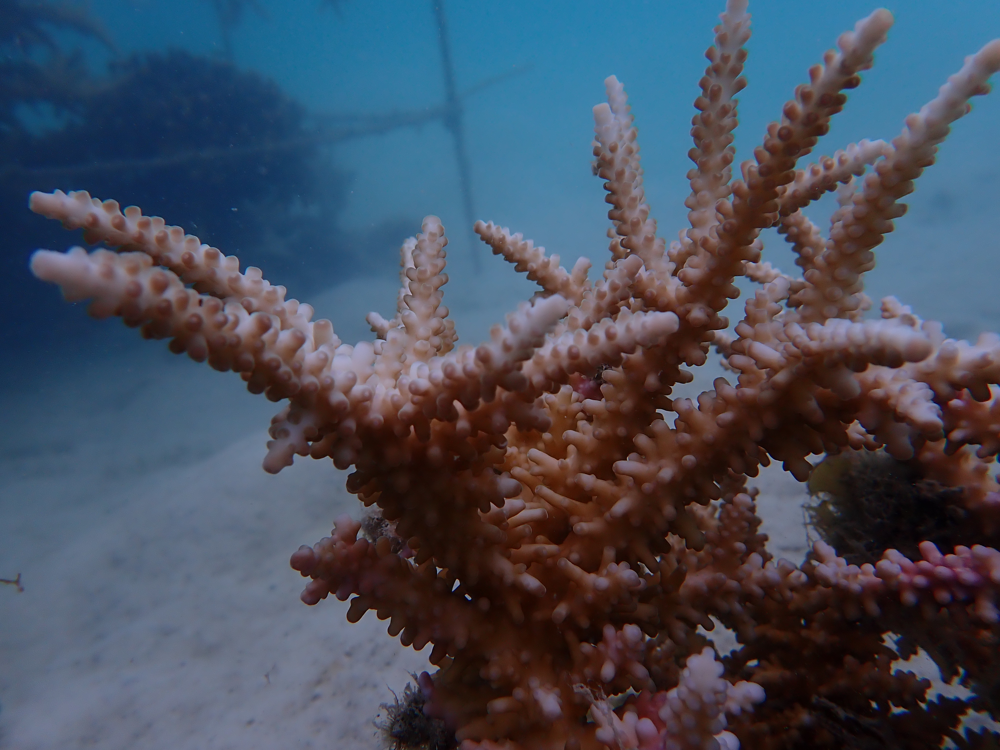

In [12]:
img_file='D:\Tugas Akhir\Dataset\Olympus TG-6\Foto\P. Kelapa Dua\Juni_7_2023\Juni_7_2023_Data Lapangan\P6070061.JPG'
Image(filename=img_file)

In [13]:
# Test the new model
preprocessed_image = prepare_image(img_file)
predictions = model.predict(preprocessed_image)
maxindex = int(np.argmax(predictions))
print(predictions[0][maxindex],prediction_dict[maxindex])

1/1 [==============================] - 1s 1s/step
1.0 branching


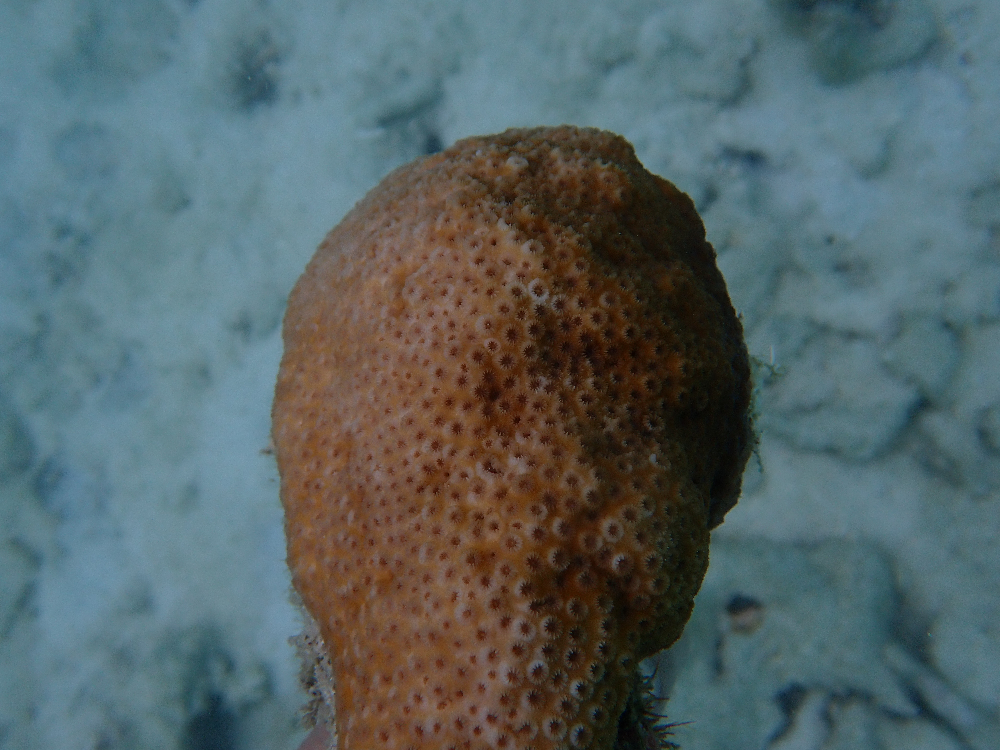

In [14]:
img_file='D:\Tugas Akhir\Dataset\Olympus TG-6\Foto\P. Kelapa Dua\Juni_7_2023\Juni_7_2023_Data Lapangan\P6070134.JPG'
Image(filename=img_file)

In [15]:
# Test the new model
preprocessed_image = prepare_image(img_file)
predictions = model.predict(preprocessed_image)
maxindex = int(np.argmax(predictions))
print(predictions[0][maxindex],prediction_dict[maxindex])

1/1 [==============================] - 0s 56ms/step
1.0 boulder


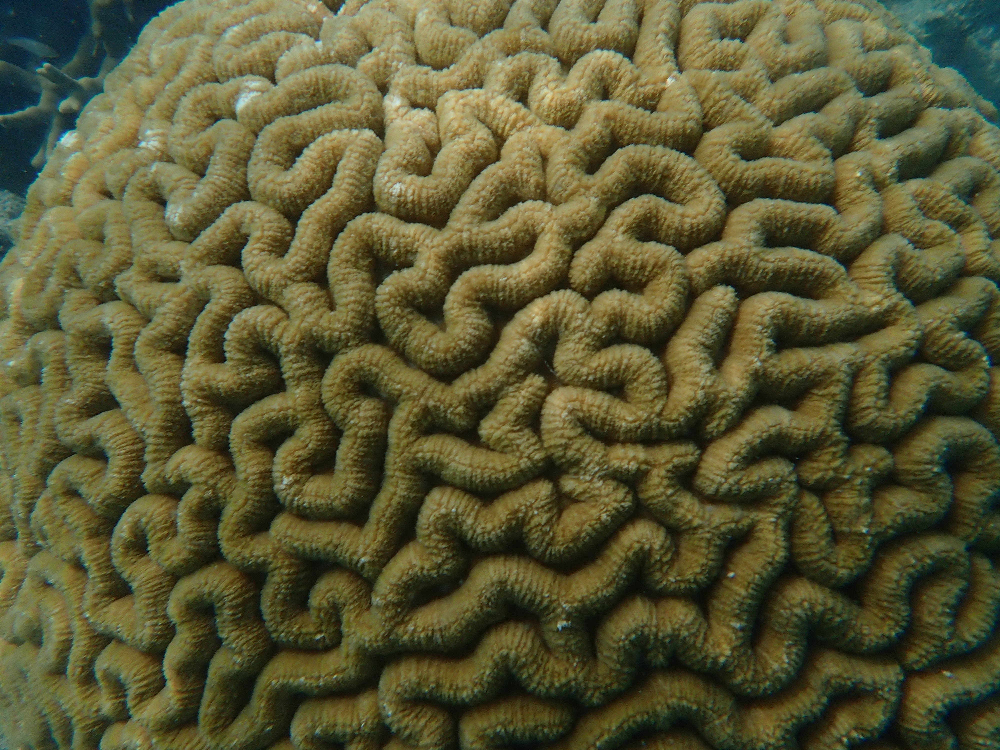

In [16]:
img_file='D:\Tugas Akhir\Dataset\Olympus TG-6\Foto\P. Kelapa Dua\Juni_8_2023\Juni_8_2023_Data Lapangan\P6080094.JPG'
Image(filename=img_file)

In [17]:
# Test the new model
preprocessed_image = prepare_image(img_file)
predictions = model.predict(preprocessed_image)
print(predictions[0])

1/1 [==============================] - 0s 54ms/step
[9.999721e-01 2.792762e-05]


In [18]:
# Test the new model
preprocessed_image = prepare_image(img_file)
predictions = model.predict(preprocessed_image)
maxindex = int(np.argmax(predictions))
print(predictions[0][maxindex],prediction_dict[maxindex])

1/1 [==============================] - 0s 49ms/step
0.9999721 boulder
